# Objective
* Review camera locations in Calgary and find correlation to accident counts

# Import Libraries

In [27]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium.plugins import MarkerCluster
import Grid_Analysis as ga
import Accidents as acc
print("check")

check


Include Sign Functions to be exported to its own py file later

In [3]:
#Load the Traffic_Sign.csv and take only sign count and point rows. Send back a df
def get_sign_df():
    print("entering add_sign_df")
    """
    Reads Traffic_Signs.csv into df keeping only count and coordinate columns
    :return: df of Traffic Signs with only count and coordinate columns
    """
    df_signs = pd.read_csv("Traffic_Signs.csv")
    data = [df_signs["SGN_COUNT_NO"], df_signs["POINT"]]
    headers =["count",'coordinate']
    res = pd.concat(data, axis=1, keys=headers)
    return res

In [4]:
#Takes coordinate data from sign df and adds two columns longitude and lattitude (float)
def add_sign_latlong(df_signs):
    print("entering add_sign_latlong")
    """
    Adds the longitude and lattitude columns to the Traffic Signs dataframe using the coordinate column
    :param df_signs: a dataframe with columns longitude and latitude
    :return: an updated dataframe with columns longitude and latitude
    """
    df=df_signs
    df["coordinate"]=df["coordinate"].apply(lambda x: str(x).replace("POINT (","")).replace(")","")
    df["coordinate"]=df["coordinate"].apply(lambda x: str(x).split(' '))
    df[['longitude','latitude']] = pd.DataFrame(df.coordinate.tolist(), index= df.index)
    df['longitude'] = df['longitude'].str.strip('[]()').astype(float)
    df['latitude'] = df['latitude'].str.strip('[]()').astype(float)
    return df

In [ ]:
print("check")
df_sign = get_sign_df()
df_sign = add_sign_latlong(df_sign)
print("check")

df_sign

# Import Sign DataSet

In [15]:
df = pd.read_csv("Traffic_Signs.csv")
df['BLADE_TYPE'].value_counts()

Street Name             42762
Parking Restrictions    33794
Regulatory              23315
Warning                 17953
Stop                    12856
Timed Parking           10682
Playground               9743
Yield                    9406
Pedestrian               8908
Guide / Information      7588
Residential Parking      5875
Disabled Parking         4522
Speed                    4355
Bicycle / Pathway        4199
Park Plus                3808
Snow Route               2761
Loading Zone             2141
School                   2019
Overhead Guide            450
Hospital                  139
Halo                       10
Name: BLADE_TYPE, dtype: int64

In [16]:
#Drop unimportant signs, keep only necessary columns, reset index.

df=df[df['BLADE_TYPE'].isin(['Speed','School','Playground','Yield','Stop'])]
data=[df.BLADE_TYPE,df.SGN_COUNT_NO,df.POINT]
df = pd.concat(data,axis=1)
df= df.rename(columns={'BLADE_TYPE':"sign_type", 'SGN_COUNT_NO':'sign_count','POINT':'coordinate'})
df= df.reset_index(drop=True)
df

,sign_type,sign_count,coordinate
0,Yield,0.0,POINT (-114.094374668366 50.97932823916)
1,Stop,2.0,POINT (-114.050415908751 51.047132018374)
2,Stop,0.0,POINT (-114.109678007362 51.023129992642)
3,Stop,4.0,POINT (-114.050685051172 51.047205670797)
4,Yield,0.0,POINT (-114.09441056135 50.979431963661)
...,...,...,...
38374,Stop,3.0,POINT (-114.197288584804 51.093980736144)
38375,Stop,2.0,POINT (-114.048354211088 51.090142270424)
38376,Playground,1.0,POINT (-114.216564811046 51.059319356325)
38377,Speed,1.0,POINT (-113.958452740811 50.969602409926)


In [18]:
#Condition coordinate data such that the format is string : lat long to use ga.methods
df["coordinate"]=df["coordinate"].apply(lambda x: str(x).replace("POINT (","")).replace(")","")
df["coordinate"]=df["coordinate"].apply(lambda x: str(x).strip(')'))
df

,sign_type,sign_count,coordinate
0,Yield,0.0,-114.094374668366 50.97932823916
1,Stop,2.0,-114.050415908751 51.047132018374
2,Stop,0.0,-114.109678007362 51.023129992642
3,Stop,4.0,-114.050685051172 51.047205670797
4,Yield,0.0,-114.09441056135 50.979431963661
...,...,...,...
38374,Stop,3.0,-114.197288584804 51.093980736144
38375,Stop,2.0,-114.048354211088 51.090142270424
38376,Playground,1.0,-114.216564811046 51.059319356325
38377,Speed,1.0,-113.958452740811 50.969602409926


In [19]:
#Create longitude and latitude columns for ploting distribution
df["coordinate"]=df["coordinate"].apply(lambda x: str(x).split(' '))
df[['longitude','latitude']] = pd.DataFrame(df.coordinate.tolist(), index= df.index)
df['longitude'] = df['longitude'].str.strip('[]()').astype(float)
df['latitude'] = df['latitude'].str.strip('[]()').astype(float)
df

,sign_type,sign_count,coordinate,longitude,latitude
0,Yield,0.0,"[-114.094374668366, 50.97932823916]",-114.094375,50.979328
1,Stop,2.0,"[-114.050415908751, 51.047132018374]",-114.050416,51.047132
2,Stop,0.0,"[-114.109678007362, 51.023129992642]",-114.109678,51.023130
3,Stop,4.0,"[-114.050685051172, 51.047205670797]",-114.050685,51.047206
4,Yield,0.0,"[-114.09441056135, 50.979431963661]",-114.094411,50.979432
...,...,...,...,...,...
38374,Stop,3.0,"[-114.197288584804, 51.093980736144]",-114.197289,51.093981
38375,Stop,2.0,"[-114.048354211088, 51.090142270424]",-114.048354,51.090142
38376,Playground,1.0,"[-114.216564811046, 51.059319356325]",-114.216565,51.059319
38377,Speed,1.0,"[-113.958452740811, 50.969602409926]",-113.958453,50.969602


# Analyze

## Distribution of Traffic Signs

In [20]:
base_coordinates = [51.044270, -114.062019]
map = folium.Map(location=base_coordinates)

sign_cluster = MarkerCluster().add_to(map)

for idx, row in df.iterrows():
    print("processing:", idx)
    folium.Marker([row['latitude'], row['longitude']],
                 popup='sign').add_to(sign_cluster)
print("check")
map

processing: 0
processing: 1
processing: 2
processing: 3
processing: 4
processing: 5
processing: 6
processing: 7
processing: 8
processing: 9
processing: 10
processing: 11
processing: 12
processing: 13
processing: 14
processing: 15
processing: 16
processing: 17
processing: 18
processing: 19
processing: 20
processing: 21
processing: 22
processing: 23
processing: 24
processing: 25
processing: 26
processing: 27
processing: 28
processing: 29
processing: 30
processing: 31
processing: 32
processing: 33
processing: 34
processing: 35
processing: 36
processing: 37
processing: 38
processing: 39
processing: 40
processing: 41
processing: 42
processing: 43
processing: 44
processing: 45
processing: 46
processing: 47
processing: 48
processing: 49
processing: 50
processing: 51
processing: 52
processing: 53
processing: 54
processing: 55
processing: 56
processing: 57
processing: 58
processing: 59
processing: 60
processing: 61
processing: 62
processing: 63
processing: 64
processing: 65
processing: 66
proce

processing: 919
processing: 920
processing: 921
processing: 922
processing: 923
processing: 924
processing: 925
processing: 926
processing: 927
processing: 928
processing: 929
processing: 930
processing: 931
processing: 932
processing: 933
processing: 934
processing: 935
processing: 936
processing: 937
processing: 938
processing: 939
processing: 940
processing: 941
processing: 942
processing: 943
processing: 944
processing: 945
processing: 946
processing: 947
processing: 948
processing: 949
processing: 950
processing: 951
processing: 952
processing: 953
processing: 954
processing: 955
processing: 956
processing: 957
processing: 958
processing: 959
processing: 960
processing: 961
processing: 962
processing: 963
processing: 964
processing: 965
processing: 966
processing: 967
processing: 968
processing: 969
processing: 970
processing: 971
processing: 972
processing: 973
processing: 974
processing: 975
processing: 976
processing: 977
processing: 978
processing: 979
processing: 980
processi

processing: 1668
processing: 1669
processing: 1670
processing: 1671
processing: 1672
processing: 1673
processing: 1674
processing: 1675
processing: 1676
processing: 1677
processing: 1678
processing: 1679
processing: 1680
processing: 1681
processing: 1682
processing: 1683
processing: 1684
processing: 1685
processing: 1686
processing: 1687
processing: 1688
processing: 1689
processing: 1690
processing: 1691
processing: 1692
processing: 1693
processing: 1694
processing: 1695
processing: 1696
processing: 1697
processing: 1698
processing: 1699
processing: 1700
processing: 1701
processing: 1702
processing: 1703
processing: 1704
processing: 1705
processing: 1706
processing: 1707
processing: 1708
processing: 1709
processing: 1710
processing: 1711
processing: 1712
processing: 1713
processing: 1714
processing: 1715
processing: 1716
processing: 1717
processing: 1718
processing: 1719
processing: 1720
processing: 1721
processing: 1722
processing: 1723
processing: 1724
processing: 1725
processing: 17

processing: 2168
processing: 2169
processing: 2170
processing: 2171
processing: 2172
processing: 2173
processing: 2174
processing: 2175
processing: 2176
processing: 2177
processing: 2178
processing: 2179
processing: 2180
processing: 2181
processing: 2182
processing: 2183
processing: 2184
processing: 2185
processing: 2186
processing: 2187
processing: 2188
processing: 2189
processing: 2190
processing: 2191
processing: 2192
processing: 2193
processing: 2194
processing: 2195
processing: 2196
processing: 2197
processing: 2198
processing: 2199
processing: 2200
processing: 2201
processing: 2202
processing: 2203
processing: 2204
processing: 2205
processing: 2206
processing: 2207
processing: 2208
processing: 2209
processing: 2210
processing: 2211
processing: 2212
processing: 2213
processing: 2214
processing: 2215
processing: 2216
processing: 2217
processing: 2218
processing: 2219
processing: 2220
processing: 2221
processing: 2222
processing: 2223
processing: 2224
processing: 2225
processing: 22

processing: 3106
processing: 3107
processing: 3108
processing: 3109
processing: 3110
processing: 3111
processing: 3112
processing: 3113
processing: 3114
processing: 3115
processing: 3116
processing: 3117
processing: 3118
processing: 3119
processing: 3120
processing: 3121
processing: 3122
processing: 3123
processing: 3124
processing: 3125
processing: 3126
processing: 3127
processing: 3128
processing: 3129
processing: 3130
processing: 3131
processing: 3132
processing: 3133
processing: 3134
processing: 3135
processing: 3136
processing: 3137
processing: 3138
processing: 3139
processing: 3140
processing: 3141
processing: 3142
processing: 3143
processing: 3144
processing: 3145
processing: 3146
processing: 3147
processing: 3148
processing: 3149
processing: 3150
processing: 3151
processing: 3152
processing: 3153
processing: 3154
processing: 3155
processing: 3156
processing: 3157
processing: 3158
processing: 3159
processing: 3160
processing: 3161
processing: 3162
processing: 3163
processing: 31

processing: 4023
processing: 4024
processing: 4025
processing: 4026
processing: 4027
processing: 4028
processing: 4029
processing: 4030
processing: 4031
processing: 4032
processing: 4033
processing: 4034
processing: 4035
processing: 4036
processing: 4037
processing: 4038
processing: 4039
processing: 4040
processing: 4041
processing: 4042
processing: 4043
processing: 4044
processing: 4045
processing: 4046
processing: 4047
processing: 4048
processing: 4049
processing: 4050
processing: 4051
processing: 4052
processing: 4053
processing: 4054
processing: 4055
processing: 4056
processing: 4057
processing: 4058
processing: 4059
processing: 4060
processing: 4061
processing: 4062
processing: 4063
processing: 4064
processing: 4065
processing: 4066
processing: 4067
processing: 4068
processing: 4069
processing: 4070
processing: 4071
processing: 4072
processing: 4073
processing: 4074
processing: 4075
processing: 4076
processing: 4077
processing: 4078
processing: 4079
processing: 4080
processing: 40

processing: 4936
processing: 4937
processing: 4938
processing: 4939
processing: 4940
processing: 4941
processing: 4942
processing: 4943
processing: 4944
processing: 4945
processing: 4946
processing: 4947
processing: 4948
processing: 4949
processing: 4950
processing: 4951
processing: 4952
processing: 4953
processing: 4954
processing: 4955
processing: 4956
processing: 4957
processing: 4958
processing: 4959
processing: 4960
processing: 4961
processing: 4962
processing: 4963
processing: 4964
processing: 4965
processing: 4966
processing: 4967
processing: 4968
processing: 4969
processing: 4970
processing: 4971
processing: 4972
processing: 4973
processing: 4974
processing: 4975
processing: 4976
processing: 4977
processing: 4978
processing: 4979
processing: 4980
processing: 4981
processing: 4982
processing: 4983
processing: 4984
processing: 4985
processing: 4986
processing: 4987
processing: 4988
processing: 4989
processing: 4990
processing: 4991
processing: 4992
processing: 4993
processing: 49

processing: 5615
processing: 5616
processing: 5617
processing: 5618
processing: 5619
processing: 5620
processing: 5621
processing: 5622
processing: 5623
processing: 5624
processing: 5625
processing: 5626
processing: 5627
processing: 5628
processing: 5629
processing: 5630
processing: 5631
processing: 5632
processing: 5633
processing: 5634
processing: 5635
processing: 5636
processing: 5637
processing: 5638
processing: 5639
processing: 5640
processing: 5641
processing: 5642
processing: 5643
processing: 5644
processing: 5645
processing: 5646
processing: 5647
processing: 5648
processing: 5649
processing: 5650
processing: 5651
processing: 5652
processing: 5653
processing: 5654
processing: 5655
processing: 5656
processing: 5657
processing: 5658
processing: 5659
processing: 5660
processing: 5661
processing: 5662
processing: 5663
processing: 5664
processing: 5665
processing: 5666
processing: 5667
processing: 5668
processing: 5669
processing: 5670
processing: 5671
processing: 5672
processing: 56

processing: 6166
processing: 6167
processing: 6168
processing: 6169
processing: 6170
processing: 6171
processing: 6172
processing: 6173
processing: 6174
processing: 6175
processing: 6176
processing: 6177
processing: 6178
processing: 6179
processing: 6180
processing: 6181
processing: 6182
processing: 6183
processing: 6184
processing: 6185
processing: 6186
processing: 6187
processing: 6188
processing: 6189
processing: 6190
processing: 6191
processing: 6192
processing: 6193
processing: 6194
processing: 6195
processing: 6196
processing: 6197
processing: 6198
processing: 6199
processing: 6200
processing: 6201
processing: 6202
processing: 6203
processing: 6204
processing: 6205
processing: 6206
processing: 6207
processing: 6208
processing: 6209
processing: 6210
processing: 6211
processing: 6212
processing: 6213
processing: 6214
processing: 6215
processing: 6216
processing: 6217
processing: 6218
processing: 6219
processing: 6220
processing: 6221
processing: 6222
processing: 6223
processing: 62

processing: 7078
processing: 7079
processing: 7080
processing: 7081
processing: 7082
processing: 7083
processing: 7084
processing: 7085
processing: 7086
processing: 7087
processing: 7088
processing: 7089
processing: 7090
processing: 7091
processing: 7092
processing: 7093
processing: 7094
processing: 7095
processing: 7096
processing: 7097
processing: 7098
processing: 7099
processing: 7100
processing: 7101
processing: 7102
processing: 7103
processing: 7104
processing: 7105
processing: 7106
processing: 7107
processing: 7108
processing: 7109
processing: 7110
processing: 7111
processing: 7112
processing: 7113
processing: 7114
processing: 7115
processing: 7116
processing: 7117
processing: 7118
processing: 7119
processing: 7120
processing: 7121
processing: 7122
processing: 7123
processing: 7124
processing: 7125
processing: 7126
processing: 7127
processing: 7128
processing: 7129
processing: 7130
processing: 7131
processing: 7132
processing: 7133
processing: 7134
processing: 7135
processing: 71

processing: 7983
processing: 7984
processing: 7985
processing: 7986
processing: 7987
processing: 7988
processing: 7989
processing: 7990
processing: 7991
processing: 7992
processing: 7993
processing: 7994
processing: 7995
processing: 7996
processing: 7997
processing: 7998
processing: 7999
processing: 8000
processing: 8001
processing: 8002
processing: 8003
processing: 8004
processing: 8005
processing: 8006
processing: 8007
processing: 8008
processing: 8009
processing: 8010
processing: 8011
processing: 8012
processing: 8013
processing: 8014
processing: 8015
processing: 8016
processing: 8017
processing: 8018
processing: 8019
processing: 8020
processing: 8021
processing: 8022
processing: 8023
processing: 8024
processing: 8025
processing: 8026
processing: 8027
processing: 8028
processing: 8029
processing: 8030
processing: 8031
processing: 8032
processing: 8033
processing: 8034
processing: 8035
processing: 8036
processing: 8037
processing: 8038
processing: 8039
processing: 8040
processing: 80

processing: 8823
processing: 8824
processing: 8825
processing: 8826
processing: 8827
processing: 8828
processing: 8829
processing: 8830
processing: 8831
processing: 8832
processing: 8833
processing: 8834
processing: 8835
processing: 8836
processing: 8837
processing: 8838
processing: 8839
processing: 8840
processing: 8841
processing: 8842
processing: 8843
processing: 8844
processing: 8845
processing: 8846
processing: 8847
processing: 8848
processing: 8849
processing: 8850
processing: 8851
processing: 8852
processing: 8853
processing: 8854
processing: 8855
processing: 8856
processing: 8857
processing: 8858
processing: 8859
processing: 8860
processing: 8861
processing: 8862
processing: 8863
processing: 8864
processing: 8865
processing: 8866
processing: 8867
processing: 8868
processing: 8869
processing: 8870
processing: 8871
processing: 8872
processing: 8873
processing: 8874
processing: 8875
processing: 8876
processing: 8877
processing: 8878
processing: 8879
processing: 8880
processing: 88

processing: 9780
processing: 9781
processing: 9782
processing: 9783
processing: 9784
processing: 9785
processing: 9786
processing: 9787
processing: 9788
processing: 9789
processing: 9790
processing: 9791
processing: 9792
processing: 9793
processing: 9794
processing: 9795
processing: 9796
processing: 9797
processing: 9798
processing: 9799
processing: 9800
processing: 9801
processing: 9802
processing: 9803
processing: 9804
processing: 9805
processing: 9806
processing: 9807
processing: 9808
processing: 9809
processing: 9810
processing: 9811
processing: 9812
processing: 9813
processing: 9814
processing: 9815
processing: 9816
processing: 9817
processing: 9818
processing: 9819
processing: 9820
processing: 9821
processing: 9822
processing: 9823
processing: 9824
processing: 9825
processing: 9826
processing: 9827
processing: 9828
processing: 9829
processing: 9830
processing: 9831
processing: 9832
processing: 9833
processing: 9834
processing: 9835
processing: 9836
processing: 9837
processing: 98

processing: 10687
processing: 10688
processing: 10689
processing: 10690
processing: 10691
processing: 10692
processing: 10693
processing: 10694
processing: 10695
processing: 10696
processing: 10697
processing: 10698
processing: 10699
processing: 10700
processing: 10701
processing: 10702
processing: 10703
processing: 10704
processing: 10705
processing: 10706
processing: 10707
processing: 10708
processing: 10709
processing: 10710
processing: 10711
processing: 10712
processing: 10713
processing: 10714
processing: 10715
processing: 10716
processing: 10717
processing: 10718
processing: 10719
processing: 10720
processing: 10721
processing: 10722
processing: 10723
processing: 10724
processing: 10725
processing: 10726
processing: 10727
processing: 10728
processing: 10729
processing: 10730
processing: 10731
processing: 10732
processing: 10733
processing: 10734
processing: 10735
processing: 10736
processing: 10737
processing: 10738
processing: 10739
processing: 10740
processing: 10741
processing

processing: 11610
processing: 11611
processing: 11612
processing: 11613
processing: 11614
processing: 11615
processing: 11616
processing: 11617
processing: 11618
processing: 11619
processing: 11620
processing: 11621
processing: 11622
processing: 11623
processing: 11624
processing: 11625
processing: 11626
processing: 11627
processing: 11628
processing: 11629
processing: 11630
processing: 11631
processing: 11632
processing: 11633
processing: 11634
processing: 11635
processing: 11636
processing: 11637
processing: 11638
processing: 11639
processing: 11640
processing: 11641
processing: 11642
processing: 11643
processing: 11644
processing: 11645
processing: 11646
processing: 11647
processing: 11648
processing: 11649
processing: 11650
processing: 11651
processing: 11652
processing: 11653
processing: 11654
processing: 11655
processing: 11656
processing: 11657
processing: 11658
processing: 11659
processing: 11660
processing: 11661
processing: 11662
processing: 11663
processing: 11664
processing

processing: 12081
processing: 12082
processing: 12083
processing: 12084
processing: 12085
processing: 12086
processing: 12087
processing: 12088
processing: 12089
processing: 12090
processing: 12091
processing: 12092
processing: 12093
processing: 12094
processing: 12095
processing: 12096
processing: 12097
processing: 12098
processing: 12099
processing: 12100
processing: 12101
processing: 12102
processing: 12103
processing: 12104
processing: 12105
processing: 12106
processing: 12107
processing: 12108
processing: 12109
processing: 12110
processing: 12111
processing: 12112
processing: 12113
processing: 12114
processing: 12115
processing: 12116
processing: 12117
processing: 12118
processing: 12119
processing: 12120
processing: 12121
processing: 12122
processing: 12123
processing: 12124
processing: 12125
processing: 12126
processing: 12127
processing: 12128
processing: 12129
processing: 12130
processing: 12131
processing: 12132
processing: 12133
processing: 12134
processing: 12135
processing

processing: 12551
processing: 12552
processing: 12553
processing: 12554
processing: 12555
processing: 12556
processing: 12557
processing: 12558
processing: 12559
processing: 12560
processing: 12561
processing: 12562
processing: 12563
processing: 12564
processing: 12565
processing: 12566
processing: 12567
processing: 12568
processing: 12569
processing: 12570
processing: 12571
processing: 12572
processing: 12573
processing: 12574
processing: 12575
processing: 12576
processing: 12577
processing: 12578
processing: 12579
processing: 12580
processing: 12581
processing: 12582
processing: 12583
processing: 12584
processing: 12585
processing: 12586
processing: 12587
processing: 12588
processing: 12589
processing: 12590
processing: 12591
processing: 12592
processing: 12593
processing: 12594
processing: 12595
processing: 12596
processing: 12597
processing: 12598
processing: 12599
processing: 12600
processing: 12601
processing: 12602
processing: 12603
processing: 12604
processing: 12605
processing

processing: 13469
processing: 13470
processing: 13471
processing: 13472
processing: 13473
processing: 13474
processing: 13475
processing: 13476
processing: 13477
processing: 13478
processing: 13479
processing: 13480
processing: 13481
processing: 13482
processing: 13483
processing: 13484
processing: 13485
processing: 13486
processing: 13487
processing: 13488
processing: 13489
processing: 13490
processing: 13491
processing: 13492
processing: 13493
processing: 13494
processing: 13495
processing: 13496
processing: 13497
processing: 13498
processing: 13499
processing: 13500
processing: 13501
processing: 13502
processing: 13503
processing: 13504
processing: 13505
processing: 13506
processing: 13507
processing: 13508
processing: 13509
processing: 13510
processing: 13511
processing: 13512
processing: 13513
processing: 13514
processing: 13515
processing: 13516
processing: 13517
processing: 13518
processing: 13519
processing: 13520
processing: 13521
processing: 13522
processing: 13523
processing

processing: 14411
processing: 14412
processing: 14413
processing: 14414
processing: 14415
processing: 14416
processing: 14417
processing: 14418
processing: 14419
processing: 14420
processing: 14421
processing: 14422
processing: 14423
processing: 14424
processing: 14425
processing: 14426
processing: 14427
processing: 14428
processing: 14429
processing: 14430
processing: 14431
processing: 14432
processing: 14433
processing: 14434
processing: 14435
processing: 14436
processing: 14437
processing: 14438
processing: 14439
processing: 14440
processing: 14441
processing: 14442
processing: 14443
processing: 14444
processing: 14445
processing: 14446
processing: 14447
processing: 14448
processing: 14449
processing: 14450
processing: 14451
processing: 14452
processing: 14453
processing: 14454
processing: 14455
processing: 14456
processing: 14457
processing: 14458
processing: 14459
processing: 14460
processing: 14461
processing: 14462
processing: 14463
processing: 14464
processing: 14465
processing

processing: 14957
processing: 14958
processing: 14959
processing: 14960
processing: 14961
processing: 14962
processing: 14963
processing: 14964
processing: 14965
processing: 14966
processing: 14967
processing: 14968
processing: 14969
processing: 14970
processing: 14971
processing: 14972
processing: 14973
processing: 14974
processing: 14975
processing: 14976
processing: 14977
processing: 14978
processing: 14979
processing: 14980
processing: 14981
processing: 14982
processing: 14983
processing: 14984
processing: 14985
processing: 14986
processing: 14987
processing: 14988
processing: 14989
processing: 14990
processing: 14991
processing: 14992
processing: 14993
processing: 14994
processing: 14995
processing: 14996
processing: 14997
processing: 14998
processing: 14999
processing: 15000
processing: 15001
processing: 15002
processing: 15003
processing: 15004
processing: 15005
processing: 15006
processing: 15007
processing: 15008
processing: 15009
processing: 15010
processing: 15011
processing

processing: 15696
processing: 15697
processing: 15698
processing: 15699
processing: 15700
processing: 15701
processing: 15702
processing: 15703
processing: 15704
processing: 15705
processing: 15706
processing: 15707
processing: 15708
processing: 15709
processing: 15710
processing: 15711
processing: 15712
processing: 15713
processing: 15714
processing: 15715
processing: 15716
processing: 15717
processing: 15718
processing: 15719
processing: 15720
processing: 15721
processing: 15722
processing: 15723
processing: 15724
processing: 15725
processing: 15726
processing: 15727
processing: 15728
processing: 15729
processing: 15730
processing: 15731
processing: 15732
processing: 15733
processing: 15734
processing: 15735
processing: 15736
processing: 15737
processing: 15738
processing: 15739
processing: 15740
processing: 15741
processing: 15742
processing: 15743
processing: 15744
processing: 15745
processing: 15746
processing: 15747
processing: 15748
processing: 15749
processing: 15750
processing

processing: 16160
processing: 16161
processing: 16162
processing: 16163
processing: 16164
processing: 16165
processing: 16166
processing: 16167
processing: 16168
processing: 16169
processing: 16170
processing: 16171
processing: 16172
processing: 16173
processing: 16174
processing: 16175
processing: 16176
processing: 16177
processing: 16178
processing: 16179
processing: 16180
processing: 16181
processing: 16182
processing: 16183
processing: 16184
processing: 16185
processing: 16186
processing: 16187
processing: 16188
processing: 16189
processing: 16190
processing: 16191
processing: 16192
processing: 16193
processing: 16194
processing: 16195
processing: 16196
processing: 16197
processing: 16198
processing: 16199
processing: 16200
processing: 16201
processing: 16202
processing: 16203
processing: 16204
processing: 16205
processing: 16206
processing: 16207
processing: 16208
processing: 16209
processing: 16210
processing: 16211
processing: 16212
processing: 16213
processing: 16214
processing

processing: 17137
processing: 17138
processing: 17139
processing: 17140
processing: 17141
processing: 17142
processing: 17143
processing: 17144
processing: 17145
processing: 17146
processing: 17147
processing: 17148
processing: 17149
processing: 17150
processing: 17151
processing: 17152
processing: 17153
processing: 17154
processing: 17155
processing: 17156
processing: 17157
processing: 17158
processing: 17159
processing: 17160
processing: 17161
processing: 17162
processing: 17163
processing: 17164
processing: 17165
processing: 17166
processing: 17167
processing: 17168
processing: 17169
processing: 17170
processing: 17171
processing: 17172
processing: 17173
processing: 17174
processing: 17175
processing: 17176
processing: 17177
processing: 17178
processing: 17179
processing: 17180
processing: 17181
processing: 17182
processing: 17183
processing: 17184
processing: 17185
processing: 17186
processing: 17187
processing: 17188
processing: 17189
processing: 17190
processing: 17191
processing

processing: 17982
processing: 17983
processing: 17984
processing: 17985
processing: 17986
processing: 17987
processing: 17988
processing: 17989
processing: 17990
processing: 17991
processing: 17992
processing: 17993
processing: 17994
processing: 17995
processing: 17996
processing: 17997
processing: 17998
processing: 17999
processing: 18000
processing: 18001
processing: 18002
processing: 18003
processing: 18004
processing: 18005
processing: 18006
processing: 18007
processing: 18008
processing: 18009
processing: 18010
processing: 18011
processing: 18012
processing: 18013
processing: 18014
processing: 18015
processing: 18016
processing: 18017
processing: 18018
processing: 18019
processing: 18020
processing: 18021
processing: 18022
processing: 18023
processing: 18024
processing: 18025
processing: 18026
processing: 18027
processing: 18028
processing: 18029
processing: 18030
processing: 18031
processing: 18032
processing: 18033
processing: 18034
processing: 18035
processing: 18036
processing

processing: 18646
processing: 18647
processing: 18648
processing: 18649
processing: 18650
processing: 18651
processing: 18652
processing: 18653
processing: 18654
processing: 18655
processing: 18656
processing: 18657
processing: 18658
processing: 18659
processing: 18660
processing: 18661
processing: 18662
processing: 18663
processing: 18664
processing: 18665
processing: 18666
processing: 18667
processing: 18668
processing: 18669
processing: 18670
processing: 18671
processing: 18672
processing: 18673
processing: 18674
processing: 18675
processing: 18676
processing: 18677
processing: 18678
processing: 18679
processing: 18680
processing: 18681
processing: 18682
processing: 18683
processing: 18684
processing: 18685
processing: 18686
processing: 18687
processing: 18688
processing: 18689
processing: 18690
processing: 18691
processing: 18692
processing: 18693
processing: 18694
processing: 18695
processing: 18696
processing: 18697
processing: 18698
processing: 18699
processing: 18700
processing

processing: 19477
processing: 19478
processing: 19479
processing: 19480
processing: 19481
processing: 19482
processing: 19483
processing: 19484
processing: 19485
processing: 19486
processing: 19487
processing: 19488
processing: 19489
processing: 19490
processing: 19491
processing: 19492
processing: 19493
processing: 19494
processing: 19495
processing: 19496
processing: 19497
processing: 19498
processing: 19499
processing: 19500
processing: 19501
processing: 19502
processing: 19503
processing: 19504
processing: 19505
processing: 19506
processing: 19507
processing: 19508
processing: 19509
processing: 19510
processing: 19511
processing: 19512
processing: 19513
processing: 19514
processing: 19515
processing: 19516
processing: 19517
processing: 19518
processing: 19519
processing: 19520
processing: 19521
processing: 19522
processing: 19523
processing: 19524
processing: 19525
processing: 19526
processing: 19527
processing: 19528
processing: 19529
processing: 19530
processing: 19531
processing

processing: 20357
processing: 20358
processing: 20359
processing: 20360
processing: 20361
processing: 20362
processing: 20363
processing: 20364
processing: 20365
processing: 20366
processing: 20367
processing: 20368
processing: 20369
processing: 20370
processing: 20371
processing: 20372
processing: 20373
processing: 20374
processing: 20375
processing: 20376
processing: 20377
processing: 20378
processing: 20379
processing: 20380
processing: 20381
processing: 20382
processing: 20383
processing: 20384
processing: 20385
processing: 20386
processing: 20387
processing: 20388
processing: 20389
processing: 20390
processing: 20391
processing: 20392
processing: 20393
processing: 20394
processing: 20395
processing: 20396
processing: 20397
processing: 20398
processing: 20399
processing: 20400
processing: 20401
processing: 20402
processing: 20403
processing: 20404
processing: 20405
processing: 20406
processing: 20407
processing: 20408
processing: 20409
processing: 20410
processing: 20411
processing

processing: 21157
processing: 21158
processing: 21159
processing: 21160
processing: 21161
processing: 21162
processing: 21163
processing: 21164
processing: 21165
processing: 21166
processing: 21167
processing: 21168
processing: 21169
processing: 21170
processing: 21171
processing: 21172
processing: 21173
processing: 21174
processing: 21175
processing: 21176
processing: 21177
processing: 21178
processing: 21179
processing: 21180
processing: 21181
processing: 21182
processing: 21183
processing: 21184
processing: 21185
processing: 21186
processing: 21187
processing: 21188
processing: 21189
processing: 21190
processing: 21191
processing: 21192
processing: 21193
processing: 21194
processing: 21195
processing: 21196
processing: 21197
processing: 21198
processing: 21199
processing: 21200
processing: 21201
processing: 21202
processing: 21203
processing: 21204
processing: 21205
processing: 21206
processing: 21207
processing: 21208
processing: 21209
processing: 21210
processing: 21211
processing

processing: 21656
processing: 21657
processing: 21658
processing: 21659
processing: 21660
processing: 21661
processing: 21662
processing: 21663
processing: 21664
processing: 21665
processing: 21666
processing: 21667
processing: 21668
processing: 21669
processing: 21670
processing: 21671
processing: 21672
processing: 21673
processing: 21674
processing: 21675
processing: 21676
processing: 21677
processing: 21678
processing: 21679
processing: 21680
processing: 21681
processing: 21682
processing: 21683
processing: 21684
processing: 21685
processing: 21686
processing: 21687
processing: 21688
processing: 21689
processing: 21690
processing: 21691
processing: 21692
processing: 21693
processing: 21694
processing: 21695
processing: 21696
processing: 21697
processing: 21698
processing: 21699
processing: 21700
processing: 21701
processing: 21702
processing: 21703
processing: 21704
processing: 21705
processing: 21706
processing: 21707
processing: 21708
processing: 21709
processing: 21710
processing

processing: 22384
processing: 22385
processing: 22386
processing: 22387
processing: 22388
processing: 22389
processing: 22390
processing: 22391
processing: 22392
processing: 22393
processing: 22394
processing: 22395
processing: 22396
processing: 22397
processing: 22398
processing: 22399
processing: 22400
processing: 22401
processing: 22402
processing: 22403
processing: 22404
processing: 22405
processing: 22406
processing: 22407
processing: 22408
processing: 22409
processing: 22410
processing: 22411
processing: 22412
processing: 22413
processing: 22414
processing: 22415
processing: 22416
processing: 22417
processing: 22418
processing: 22419
processing: 22420
processing: 22421
processing: 22422
processing: 22423
processing: 22424
processing: 22425
processing: 22426
processing: 22427
processing: 22428
processing: 22429
processing: 22430
processing: 22431
processing: 22432
processing: 22433
processing: 22434
processing: 22435
processing: 22436
processing: 22437
processing: 22438
processing

processing: 23147
processing: 23148
processing: 23149
processing: 23150
processing: 23151
processing: 23152
processing: 23153
processing: 23154
processing: 23155
processing: 23156
processing: 23157
processing: 23158
processing: 23159
processing: 23160
processing: 23161
processing: 23162
processing: 23163
processing: 23164
processing: 23165
processing: 23166
processing: 23167
processing: 23168
processing: 23169
processing: 23170
processing: 23171
processing: 23172
processing: 23173
processing: 23174
processing: 23175
processing: 23176
processing: 23177
processing: 23178
processing: 23179
processing: 23180
processing: 23181
processing: 23182
processing: 23183
processing: 23184
processing: 23185
processing: 23186
processing: 23187
processing: 23188
processing: 23189
processing: 23190
processing: 23191
processing: 23192
processing: 23193
processing: 23194
processing: 23195
processing: 23196
processing: 23197
processing: 23198
processing: 23199
processing: 23200
processing: 23201
processing

processing: 23608
processing: 23609
processing: 23610
processing: 23611
processing: 23612
processing: 23613
processing: 23614
processing: 23615
processing: 23616
processing: 23617
processing: 23618
processing: 23619
processing: 23620
processing: 23621
processing: 23622
processing: 23623
processing: 23624
processing: 23625
processing: 23626
processing: 23627
processing: 23628
processing: 23629
processing: 23630
processing: 23631
processing: 23632
processing: 23633
processing: 23634
processing: 23635
processing: 23636
processing: 23637
processing: 23638
processing: 23639
processing: 23640
processing: 23641
processing: 23642
processing: 23643
processing: 23644
processing: 23645
processing: 23646
processing: 23647
processing: 23648
processing: 23649
processing: 23650
processing: 23651
processing: 23652
processing: 23653
processing: 23654
processing: 23655
processing: 23656
processing: 23657
processing: 23658
processing: 23659
processing: 23660
processing: 23661
processing: 23662
processing

processing: 24489
processing: 24490
processing: 24491
processing: 24492
processing: 24493
processing: 24494
processing: 24495
processing: 24496
processing: 24497
processing: 24498
processing: 24499
processing: 24500
processing: 24501
processing: 24502
processing: 24503
processing: 24504
processing: 24505
processing: 24506
processing: 24507
processing: 24508
processing: 24509
processing: 24510
processing: 24511
processing: 24512
processing: 24513
processing: 24514
processing: 24515
processing: 24516
processing: 24517
processing: 24518
processing: 24519
processing: 24520
processing: 24521
processing: 24522
processing: 24523
processing: 24524
processing: 24525
processing: 24526
processing: 24527
processing: 24528
processing: 24529
processing: 24530
processing: 24531
processing: 24532
processing: 24533
processing: 24534
processing: 24535
processing: 24536
processing: 24537
processing: 24538
processing: 24539
processing: 24540
processing: 24541
processing: 24542
processing: 24543
processing

processing: 25404
processing: 25405
processing: 25406
processing: 25407
processing: 25408
processing: 25409
processing: 25410
processing: 25411
processing: 25412
processing: 25413
processing: 25414
processing: 25415
processing: 25416
processing: 25417
processing: 25418
processing: 25419
processing: 25420
processing: 25421
processing: 25422
processing: 25423
processing: 25424
processing: 25425
processing: 25426
processing: 25427
processing: 25428
processing: 25429
processing: 25430
processing: 25431
processing: 25432
processing: 25433
processing: 25434
processing: 25435
processing: 25436
processing: 25437
processing: 25438
processing: 25439
processing: 25440
processing: 25441
processing: 25442
processing: 25443
processing: 25444
processing: 25445
processing: 25446
processing: 25447
processing: 25448
processing: 25449
processing: 25450
processing: 25451
processing: 25452
processing: 25453
processing: 25454
processing: 25455
processing: 25456
processing: 25457
processing: 25458
processing

processing: 25904
processing: 25905
processing: 25906
processing: 25907
processing: 25908
processing: 25909
processing: 25910
processing: 25911
processing: 25912
processing: 25913
processing: 25914
processing: 25915
processing: 25916
processing: 25917
processing: 25918
processing: 25919
processing: 25920
processing: 25921
processing: 25922
processing: 25923
processing: 25924
processing: 25925
processing: 25926
processing: 25927
processing: 25928
processing: 25929
processing: 25930
processing: 25931
processing: 25932
processing: 25933
processing: 25934
processing: 25935
processing: 25936
processing: 25937
processing: 25938
processing: 25939
processing: 25940
processing: 25941
processing: 25942
processing: 25943
processing: 25944
processing: 25945
processing: 25946
processing: 25947
processing: 25948
processing: 25949
processing: 25950
processing: 25951
processing: 25952
processing: 25953
processing: 25954
processing: 25955
processing: 25956
processing: 25957
processing: 25958
processing

processing: 26372
processing: 26373
processing: 26374
processing: 26375
processing: 26376
processing: 26377
processing: 26378
processing: 26379
processing: 26380
processing: 26381
processing: 26382
processing: 26383
processing: 26384
processing: 26385
processing: 26386
processing: 26387
processing: 26388
processing: 26389
processing: 26390
processing: 26391
processing: 26392
processing: 26393
processing: 26394
processing: 26395
processing: 26396
processing: 26397
processing: 26398
processing: 26399
processing: 26400
processing: 26401
processing: 26402
processing: 26403
processing: 26404
processing: 26405
processing: 26406
processing: 26407
processing: 26408
processing: 26409
processing: 26410
processing: 26411
processing: 26412
processing: 26413
processing: 26414
processing: 26415
processing: 26416
processing: 26417
processing: 26418
processing: 26419
processing: 26420
processing: 26421
processing: 26422
processing: 26423
processing: 26424
processing: 26425
processing: 26426
processing

processing: 26854
processing: 26855
processing: 26856
processing: 26857
processing: 26858
processing: 26859
processing: 26860
processing: 26861
processing: 26862
processing: 26863
processing: 26864
processing: 26865
processing: 26866
processing: 26867
processing: 26868
processing: 26869
processing: 26870
processing: 26871
processing: 26872
processing: 26873
processing: 26874
processing: 26875
processing: 26876
processing: 26877
processing: 26878
processing: 26879
processing: 26880
processing: 26881
processing: 26882
processing: 26883
processing: 26884
processing: 26885
processing: 26886
processing: 26887
processing: 26888
processing: 26889
processing: 26890
processing: 26891
processing: 26892
processing: 26893
processing: 26894
processing: 26895
processing: 26896
processing: 26897
processing: 26898
processing: 26899
processing: 26900
processing: 26901
processing: 26902
processing: 26903
processing: 26904
processing: 26905
processing: 26906
processing: 26907
processing: 26908
processing

processing: 27758
processing: 27759
processing: 27760
processing: 27761
processing: 27762
processing: 27763
processing: 27764
processing: 27765
processing: 27766
processing: 27767
processing: 27768
processing: 27769
processing: 27770
processing: 27771
processing: 27772
processing: 27773
processing: 27774
processing: 27775
processing: 27776
processing: 27777
processing: 27778
processing: 27779
processing: 27780
processing: 27781
processing: 27782
processing: 27783
processing: 27784
processing: 27785
processing: 27786
processing: 27787
processing: 27788
processing: 27789
processing: 27790
processing: 27791
processing: 27792
processing: 27793
processing: 27794
processing: 27795
processing: 27796
processing: 27797
processing: 27798
processing: 27799
processing: 27800
processing: 27801
processing: 27802
processing: 27803
processing: 27804
processing: 27805
processing: 27806
processing: 27807
processing: 27808
processing: 27809
processing: 27810
processing: 27811
processing: 27812
processing

processing: 28226
processing: 28227
processing: 28228
processing: 28229
processing: 28230
processing: 28231
processing: 28232
processing: 28233
processing: 28234
processing: 28235
processing: 28236
processing: 28237
processing: 28238
processing: 28239
processing: 28240
processing: 28241
processing: 28242
processing: 28243
processing: 28244
processing: 28245
processing: 28246
processing: 28247
processing: 28248
processing: 28249
processing: 28250
processing: 28251
processing: 28252
processing: 28253
processing: 28254
processing: 28255
processing: 28256
processing: 28257
processing: 28258
processing: 28259
processing: 28260
processing: 28261
processing: 28262
processing: 28263
processing: 28264
processing: 28265
processing: 28266
processing: 28267
processing: 28268
processing: 28269
processing: 28270
processing: 28271
processing: 28272
processing: 28273
processing: 28274
processing: 28275
processing: 28276
processing: 28277
processing: 28278
processing: 28279
processing: 28280
processing

processing: 28709
processing: 28710
processing: 28711
processing: 28712
processing: 28713
processing: 28714
processing: 28715
processing: 28716
processing: 28717
processing: 28718
processing: 28719
processing: 28720
processing: 28721
processing: 28722
processing: 28723
processing: 28724
processing: 28725
processing: 28726
processing: 28727
processing: 28728
processing: 28729
processing: 28730
processing: 28731
processing: 28732
processing: 28733
processing: 28734
processing: 28735
processing: 28736
processing: 28737
processing: 28738
processing: 28739
processing: 28740
processing: 28741
processing: 28742
processing: 28743
processing: 28744
processing: 28745
processing: 28746
processing: 28747
processing: 28748
processing: 28749
processing: 28750
processing: 28751
processing: 28752
processing: 28753
processing: 28754
processing: 28755
processing: 28756
processing: 28757
processing: 28758
processing: 28759
processing: 28760
processing: 28761
processing: 28762
processing: 28763
processing

processing: 29169
processing: 29170
processing: 29171
processing: 29172
processing: 29173
processing: 29174
processing: 29175
processing: 29176
processing: 29177
processing: 29178
processing: 29179
processing: 29180
processing: 29181
processing: 29182
processing: 29183
processing: 29184
processing: 29185
processing: 29186
processing: 29187
processing: 29188
processing: 29189
processing: 29190
processing: 29191
processing: 29192
processing: 29193
processing: 29194
processing: 29195
processing: 29196
processing: 29197
processing: 29198
processing: 29199
processing: 29200
processing: 29201
processing: 29202
processing: 29203
processing: 29204
processing: 29205
processing: 29206
processing: 29207
processing: 29208
processing: 29209
processing: 29210
processing: 29211
processing: 29212
processing: 29213
processing: 29214
processing: 29215
processing: 29216
processing: 29217
processing: 29218
processing: 29219
processing: 29220
processing: 29221
processing: 29222
processing: 29223
processing

processing: 29724
processing: 29725
processing: 29726
processing: 29727
processing: 29728
processing: 29729
processing: 29730
processing: 29731
processing: 29732
processing: 29733
processing: 29734
processing: 29735
processing: 29736
processing: 29737
processing: 29738
processing: 29739
processing: 29740
processing: 29741
processing: 29742
processing: 29743
processing: 29744
processing: 29745
processing: 29746
processing: 29747
processing: 29748
processing: 29749
processing: 29750
processing: 29751
processing: 29752
processing: 29753
processing: 29754
processing: 29755
processing: 29756
processing: 29757
processing: 29758
processing: 29759
processing: 29760
processing: 29761
processing: 29762
processing: 29763
processing: 29764
processing: 29765
processing: 29766
processing: 29767
processing: 29768
processing: 29769
processing: 29770
processing: 29771
processing: 29772
processing: 29773
processing: 29774
processing: 29775
processing: 29776
processing: 29777
processing: 29778
processing

processing: 30651
processing: 30652
processing: 30653
processing: 30654
processing: 30655
processing: 30656
processing: 30657
processing: 30658
processing: 30659
processing: 30660
processing: 30661
processing: 30662
processing: 30663
processing: 30664
processing: 30665
processing: 30666
processing: 30667
processing: 30668
processing: 30669
processing: 30670
processing: 30671
processing: 30672
processing: 30673
processing: 30674
processing: 30675
processing: 30676
processing: 30677
processing: 30678
processing: 30679
processing: 30680
processing: 30681
processing: 30682
processing: 30683
processing: 30684
processing: 30685
processing: 30686
processing: 30687
processing: 30688
processing: 30689
processing: 30690
processing: 30691
processing: 30692
processing: 30693
processing: 30694
processing: 30695
processing: 30696
processing: 30697
processing: 30698
processing: 30699
processing: 30700
processing: 30701
processing: 30702
processing: 30703
processing: 30704
processing: 30705
processing

processing: 31459
processing: 31460
processing: 31461
processing: 31462
processing: 31463
processing: 31464
processing: 31465
processing: 31466
processing: 31467
processing: 31468
processing: 31469
processing: 31470
processing: 31471
processing: 31472
processing: 31473
processing: 31474
processing: 31475
processing: 31476
processing: 31477
processing: 31478
processing: 31479
processing: 31480
processing: 31481
processing: 31482
processing: 31483
processing: 31484
processing: 31485
processing: 31486
processing: 31487
processing: 31488
processing: 31489
processing: 31490
processing: 31491
processing: 31492
processing: 31493
processing: 31494
processing: 31495
processing: 31496
processing: 31497
processing: 31498
processing: 31499
processing: 31500
processing: 31501
processing: 31502
processing: 31503
processing: 31504
processing: 31505
processing: 31506
processing: 31507
processing: 31508
processing: 31509
processing: 31510
processing: 31511
processing: 31512
processing: 31513
processing

processing: 32399
processing: 32400
processing: 32401
processing: 32402
processing: 32403
processing: 32404
processing: 32405
processing: 32406
processing: 32407
processing: 32408
processing: 32409
processing: 32410
processing: 32411
processing: 32412
processing: 32413
processing: 32414
processing: 32415
processing: 32416
processing: 32417
processing: 32418
processing: 32419
processing: 32420
processing: 32421
processing: 32422
processing: 32423
processing: 32424
processing: 32425
processing: 32426
processing: 32427
processing: 32428
processing: 32429
processing: 32430
processing: 32431
processing: 32432
processing: 32433
processing: 32434
processing: 32435
processing: 32436
processing: 32437
processing: 32438
processing: 32439
processing: 32440
processing: 32441
processing: 32442
processing: 32443
processing: 32444
processing: 32445
processing: 32446
processing: 32447
processing: 32448
processing: 32449
processing: 32450
processing: 32451
processing: 32452
processing: 32453
processing

processing: 33252
processing: 33253
processing: 33254
processing: 33255
processing: 33256
processing: 33257
processing: 33258
processing: 33259
processing: 33260
processing: 33261
processing: 33262
processing: 33263
processing: 33264
processing: 33265
processing: 33266
processing: 33267
processing: 33268
processing: 33269
processing: 33270
processing: 33271
processing: 33272
processing: 33273
processing: 33274
processing: 33275
processing: 33276
processing: 33277
processing: 33278
processing: 33279
processing: 33280
processing: 33281
processing: 33282
processing: 33283
processing: 33284
processing: 33285
processing: 33286
processing: 33287
processing: 33288
processing: 33289
processing: 33290
processing: 33291
processing: 33292
processing: 33293
processing: 33294
processing: 33295
processing: 33296
processing: 33297
processing: 33298
processing: 33299
processing: 33300
processing: 33301
processing: 33302
processing: 33303
processing: 33304
processing: 33305
processing: 33306
processing

processing: 34001
processing: 34002
processing: 34003
processing: 34004
processing: 34005
processing: 34006
processing: 34007
processing: 34008
processing: 34009
processing: 34010
processing: 34011
processing: 34012
processing: 34013
processing: 34014
processing: 34015
processing: 34016
processing: 34017
processing: 34018
processing: 34019
processing: 34020
processing: 34021
processing: 34022
processing: 34023
processing: 34024
processing: 34025
processing: 34026
processing: 34027
processing: 34028
processing: 34029
processing: 34030
processing: 34031
processing: 34032
processing: 34033
processing: 34034
processing: 34035
processing: 34036
processing: 34037
processing: 34038
processing: 34039
processing: 34040
processing: 34041
processing: 34042
processing: 34043
processing: 34044
processing: 34045
processing: 34046
processing: 34047
processing: 34048
processing: 34049
processing: 34050
processing: 34051
processing: 34052
processing: 34053
processing: 34054
processing: 34055
processing

processing: 34544
processing: 34545
processing: 34546
processing: 34547
processing: 34548
processing: 34549
processing: 34550
processing: 34551
processing: 34552
processing: 34553
processing: 34554
processing: 34555
processing: 34556
processing: 34557
processing: 34558
processing: 34559
processing: 34560
processing: 34561
processing: 34562
processing: 34563
processing: 34564
processing: 34565
processing: 34566
processing: 34567
processing: 34568
processing: 34569
processing: 34570
processing: 34571
processing: 34572
processing: 34573
processing: 34574
processing: 34575
processing: 34576
processing: 34577
processing: 34578
processing: 34579
processing: 34580
processing: 34581
processing: 34582
processing: 34583
processing: 34584
processing: 34585
processing: 34586
processing: 34587
processing: 34588
processing: 34589
processing: 34590
processing: 34591
processing: 34592
processing: 34593
processing: 34594
processing: 34595
processing: 34596
processing: 34597
processing: 34598
processing

processing: 35267
processing: 35268
processing: 35269
processing: 35270
processing: 35271
processing: 35272
processing: 35273
processing: 35274
processing: 35275
processing: 35276
processing: 35277
processing: 35278
processing: 35279
processing: 35280
processing: 35281
processing: 35282
processing: 35283
processing: 35284
processing: 35285
processing: 35286
processing: 35287
processing: 35288
processing: 35289
processing: 35290
processing: 35291
processing: 35292
processing: 35293
processing: 35294
processing: 35295
processing: 35296
processing: 35297
processing: 35298
processing: 35299
processing: 35300
processing: 35301
processing: 35302
processing: 35303
processing: 35304
processing: 35305
processing: 35306
processing: 35307
processing: 35308
processing: 35309
processing: 35310
processing: 35311
processing: 35312
processing: 35313
processing: 35314
processing: 35315
processing: 35316
processing: 35317
processing: 35318
processing: 35319
processing: 35320
processing: 35321
processing

processing: 35922
processing: 35923
processing: 35924
processing: 35925
processing: 35926
processing: 35927
processing: 35928
processing: 35929
processing: 35930
processing: 35931
processing: 35932
processing: 35933
processing: 35934
processing: 35935
processing: 35936
processing: 35937
processing: 35938
processing: 35939
processing: 35940
processing: 35941
processing: 35942
processing: 35943
processing: 35944
processing: 35945
processing: 35946
processing: 35947
processing: 35948
processing: 35949
processing: 35950
processing: 35951
processing: 35952
processing: 35953
processing: 35954
processing: 35955
processing: 35956
processing: 35957
processing: 35958
processing: 35959
processing: 35960
processing: 35961
processing: 35962
processing: 35963
processing: 35964
processing: 35965
processing: 35966
processing: 35967
processing: 35968
processing: 35969
processing: 35970
processing: 35971
processing: 35972
processing: 35973
processing: 35974
processing: 35975
processing: 35976
processing

processing: 36608
processing: 36609
processing: 36610
processing: 36611
processing: 36612
processing: 36613
processing: 36614
processing: 36615
processing: 36616
processing: 36617
processing: 36618
processing: 36619
processing: 36620
processing: 36621
processing: 36622
processing: 36623
processing: 36624
processing: 36625
processing: 36626
processing: 36627
processing: 36628
processing: 36629
processing: 36630
processing: 36631
processing: 36632
processing: 36633
processing: 36634
processing: 36635
processing: 36636
processing: 36637
processing: 36638
processing: 36639
processing: 36640
processing: 36641
processing: 36642
processing: 36643
processing: 36644
processing: 36645
processing: 36646
processing: 36647
processing: 36648
processing: 36649
processing: 36650
processing: 36651
processing: 36652
processing: 36653
processing: 36654
processing: 36655
processing: 36656
processing: 36657
processing: 36658
processing: 36659
processing: 36660
processing: 36661
processing: 36662
processing

processing: 37268
processing: 37269
processing: 37270
processing: 37271
processing: 37272
processing: 37273
processing: 37274
processing: 37275
processing: 37276
processing: 37277
processing: 37278
processing: 37279
processing: 37280
processing: 37281
processing: 37282
processing: 37283
processing: 37284
processing: 37285
processing: 37286
processing: 37287
processing: 37288
processing: 37289
processing: 37290
processing: 37291
processing: 37292
processing: 37293
processing: 37294
processing: 37295
processing: 37296
processing: 37297
processing: 37298
processing: 37299
processing: 37300
processing: 37301
processing: 37302
processing: 37303
processing: 37304
processing: 37305
processing: 37306
processing: 37307
processing: 37308
processing: 37309
processing: 37310
processing: 37311
processing: 37312
processing: 37313
processing: 37314
processing: 37315
processing: 37316
processing: 37317
processing: 37318
processing: 37319
processing: 37320
processing: 37321
processing: 37322
processing

processing: 38117
processing: 38118
processing: 38119
processing: 38120
processing: 38121
processing: 38122
processing: 38123
processing: 38124
processing: 38125
processing: 38126
processing: 38127
processing: 38128
processing: 38129
processing: 38130
processing: 38131
processing: 38132
processing: 38133
processing: 38134
processing: 38135
processing: 38136
processing: 38137
processing: 38138
processing: 38139
processing: 38140
processing: 38141
processing: 38142
processing: 38143
processing: 38144
processing: 38145
processing: 38146
processing: 38147
processing: 38148
processing: 38149
processing: 38150
processing: 38151
processing: 38152
processing: 38153
processing: 38154
processing: 38155
processing: 38156
processing: 38157
processing: 38158
processing: 38159
processing: 38160
processing: 38161
processing: 38162
processing: 38163
processing: 38164
processing: 38165
processing: 38166
processing: 38167
processing: 38168
processing: 38169
processing: 38170
processing: 38171
processing

## Accidents Distribution

In [28]:
accident_counts = acc.get_accident_counts_by_location()
accident_counts

,Accident Count
"(50.994156675722, -114.039173086226)",68
"(51.048859876417, -114.019434255636)",65
"(51.067379869342, -114.028551292521)",56
"(50.996389267837, -114.101595818037)",48
"(51.000997134752, -114.121071289426)",39
...,...
"(51.157709916128, -114.01345928788)",1
"(51.008759878589, -114.001714653593)",1
"(50.902813390498, -114.098665167824)",1
"(51.004768569838, -114.118051616076)",1


In [29]:
base_coordinates = [51.044270, -114.062019]
map = folium.Map(location=base_coordinates)

accident_cluster = MarkerCluster().add_to(map)

for idx, row in accident_counts.iterrows():
    loc = idx.strip('()').split(',')
    loc = [float(i) for i in loc]
    folium.Marker(loc, popup='accident').add_to(accident_cluster)

map

## Scatter Plot

Text(0, 0.5, 'Longitude')

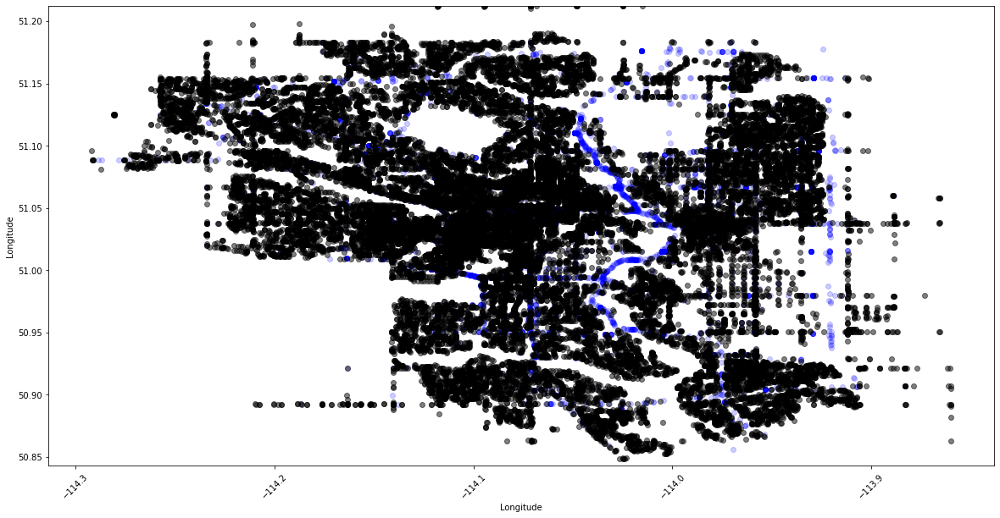

In [30]:
accidents = acc.extract_accidents('Data/Traffic_Incidents.csv', '2018')

plt.figure(figsize=(20,10))
plt.scatter(x = 'longitude', y = 'latitude', data = accidents, label = 'Accidents', c='b', alpha=0.2)
plt.scatter(x = 'longitude', y = 'latitude', data=df, label = 'Signs', c='k', alpha=0.5)
plt.ylim(50.842822, 51.212425)
plt.xticks(rotation=45)
plt.xlabel('Longitude')
plt.ylabel('Longitude')

## Grid Analysis

In [31]:
sign_grid = ga.populate_grid(df)
sign_grid

array([[0.000e+00, 4.000e+00, 3.000e+01, 2.190e+02, 2.080e+02, 1.070e+02,
        7.000e+00, 1.000e+01, 0.000e+00, 0.000e+00],
       [0.000e+00, 3.830e+02, 3.480e+02, 5.490e+02, 8.620e+02, 9.560e+02,
        2.550e+02, 3.860e+02, 7.600e+01, 3.000e+00],
       [8.000e+00, 5.220e+02, 9.330e+02, 8.210e+02, 2.190e+02, 7.130e+02,
        4.400e+01, 5.950e+02, 8.250e+02, 0.000e+00],
       [3.800e+01, 2.040e+02, 8.760e+02, 9.280e+02, 1.007e+03, 1.524e+03,
        3.360e+02, 9.070e+02, 7.110e+02, 2.000e+00],
       [0.000e+00, 2.100e+01, 9.510e+02, 1.184e+03, 1.839e+03, 2.097e+03,
        7.990e+02, 1.143e+03, 5.290e+02, 4.100e+01],
       [0.000e+00, 1.900e+01, 3.040e+02, 5.900e+02, 1.288e+03, 1.150e+03,
        3.000e+02, 5.160e+02, 4.600e+01, 2.000e+00],
       [0.000e+00, 0.000e+00, 0.000e+00, 6.600e+01, 6.420e+02, 9.640e+02,
        7.070e+02, 3.220e+02, 9.300e+01, 4.500e+01],
       [0.000e+00, 0.000e+00, 0.000e+00, 1.070e+02, 6.130e+02, 6.320e+02,
        6.160e+02, 6.840e+02, 2.900e+

In [ ]:
print('{:.0f} camera falls outside Calgary boundaries'.format(camera.shape[0]-camera_grid.sum()))

In [33]:
ga.display_grid_on_map(sign_grid[::-1].ravel(), 'sign count ')

# Conclusions
There is no clear correlation between traffic camera location and the number of accidents. 